<a href="https://colab.research.google.com/github/sofiiinj/Sum/blob/main/Proyecto_final_compu.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **ECUACIÓN DE CALOR EN DOS DIMENSIONES**

La idea del proyecto corresponde a resolver de manera numérica la ecuación de calor en dos dimensiones.  
Suponga que u = u (x, y, t) es una variable escalar que define la temperatura de una región de dos dimensiones en el plano Cartesiano (x, y) como función del tiempo. Bajo condiciones ideales (sin fuentes de energía externas, capacidad calórica uniforme, aislamiento perfecto), la ecuación de movimiento está dada por:  

$$
\frac{\partial u}{\partial t} = c^2 \left[ \frac{\partial^2 u}{\partial x^2} + \frac{\partial^2 u}{\partial y^2} \right],
$$

Para alguna región acotada $ x \in [0,a] $ y $ y \in [0,b] $. Las condiciones de frontera pueden cambiar y la dinámica está determinada por éstas y por las condiciones iniciales.  

**Objetivos del proyecto:**

- Encontrar una metodología numérica para resolver el sistema de ecuaciones  
- Implementar la solución en **Python**.  
- Implementar la solución en **C++**.  
- Utilice distintas condiciones iniciales.  
- En un gráfico de dos dimensiones con mapa de colores, encuentre una forma de visualizar la solución a través del tiempo.
- Encontrar una forma de acelerar la aplicación utilizando paralelismo de memoria compartida.  


# **Explicación de la metodología para resolver el sistema:**

## **Método de diferencias finitas para la ecuación de calor**

Este método utiliza condiciones de frontera de Dirichlet no homogéneas para poder resolver la ecuación de calor en dos dimensiones. Aquí se explica el procedimiento con sus diferentes pasos a modo resumen, cómo validarlo usando MATLAB y una idea de cómo aplicarlo a nuestro proyecto.

**1 - ESTRUCTURA DE LA ECUACIÓN DE CALOR**

Lo que queremos es encontrar la temperatura $u(x,y,t)$ en una región cuadrada del plano conforme va pasando el tiempo. Esta temperatura va a seguir la siguiente ecuación:

$$
\frac{\partial u}{\partial t} = \frac{\partial^2 u}{\partial x^2} + \frac{\partial^2 u}{\partial y^2} + f(t,x,y)
$$

donde:
- $\frac{\partial u}{\partial t}$ es el cambio de temperatura con respecto al tiempo.
- $\frac{\partial^2 u}{\partial x^2} + \frac{\partial^2 u}{\partial y^2}$ representa cómo se esparce la temperatura en el espacio.
- $f(t,x,y)$ es una fuente de calor **(en nuestro caso es cero porque no hay fuente externa)**.

Además de esto hay condiciones **iniciales** (cómo empieza la temperatura en todo el dominio) y de **frontera** (qué temperatura hay en los bordes del dominio) que siguen la sisguiente estructura:

$$
\left\{
\begin{array}{ll}
u(0,x,y) = u_0(x,y), & \text{(condición inicial)} \\[6pt]
u(t,x,y) = g(t,x,y), & \text{(condición de frontera)}
\end{array}
\right.
$$

Ahora bien, la implementación del MDF consiste en reemplazar las derivadas de la ecuación por aproximaciones usando puntos en una malla. Para esto se realizan una serie de pasos explicados en las siguientes secciones.

**2 - DISCRETIZACIÓN DEL DOMINIO**

Se considera un dominio cuadrado unitario $Q = [0,1] \times [0,1]$ y se divide una malla en puntos discretizando el tiempo y el espacio:
- **Tiempo:** $M + 1$ instantes.
- **Espacio:** $N + 2$ puntos en cada dirección (incluyendo bordes).

Esto generará una malla cartesiana de $(N+2)^2$ puntos.

Ahora se definen los pasos de las variables:
- $h = \frac{1}{N + 1}$: paso en el espacio.
- $k = \frac{T}{M}$: paso en el tiempo.

**3 - APROXIMACIÓN DE LAS DERIVADAS**

Primero, se usa un método llamado ´´esquema de 5 puntos´´ para poder aproximar las **derivadas espaciales**, o bien, el Laplaciano:

$$
\Delta u(t_n, x_i, y_j) \approx \frac{1}{h^2}
\left( u_{i+1,j} + u_{i-1,j} + u_{i,j+1} + u_{i,j-1} - 4u_{i,j} \right)
$$

Esto utiliza los puntos en las 4 direcciones cardinales del punto $(i,j)$.

Para la derivada temporal se usa el método de Euler implícito (backward Euler):

$$
\frac{u_{i,j}^n - u_{i,j}^{n-1}}{k} \approx derivada\space temporal
$$

Este método es incondicionalmente estable, lo que significa que no importa el tamaño de h y k, el método no explota.

**4 - MONTAJE DEL SISTEMA LINEAL**

Al combinar las aproximaciones, obtenemos una ecuación para cada punto interior de la malla:

$$
- u_{i-1,j}^n - u_{i,j-1}^n + (4 + \mu) u_{i,j}^n - u_{i+1,j}^n - u_{i,j+1}^n = h^2 f_{i,j}^n + \mu u_{i,j}^{n-1}
$$

donde $\mu = \dfrac{h^2}{k}$

Para cada paso de tiempo que se realice, se resuelve un sistema lineal de la siguiente forma:

$$
Au^n = b^n
$$

$A$ es una matriz constante de tamaño $N^2 \times N^2$ independiente del tiempo y construida con productos de Kronecker:

$$
A = I \otimes T + S \otimes I
$$

donde:
- $T$ es tridiagonal con $(4+\mu)$ en la diagonal $(y-1)$ en las sub/superdiagonales.
- $S$ es tridiagonal con $-1$ en las sub/superdiagonales.
- $I$ es la identidad de orden $N$.

En MATLAB se puede utilizar el siguiente código para poder contruir la matriz $A$:

```matlab
function [A] = Laplacian2DMatrix(N, mu)
  I = speye(N);
  e = -1 * ones(N, 1);
  T = spdiags([e, -(4 + mu) * e, e], [-1, 0, 1], N, N);
  S = spdiags([e, e], [-1, 1], N, N);
  A = kron(I, T) + kron(S, I);
end
```

El vector $u^n$ es un vector de incógnitas que representa la temperatura en todos los puntos interiores en el tiempo $t_n$.

Por último, el vector $b^n$ en el lado derecho de la ecuación se construye para cada tiempo $t_n$ usando:
- El término fuente $f(t_n, x_i, y_j)$
- Las condiciones de frontera $g(t_n, x, y)$
- La solución del paso anterior $u^{n-1}$

Este se puede hacer con una rutina que recorra todos los puntos y sume las contribuciones, como se aplica en el siguiente código:

```matlab
function [b] = Lapacian2DRhs(N, tn, x, y, h, f, g, mu, u)
  b = zeros(N^2, 1);
  k = N^2 - N;
  v = y(1); w = y(N);
  for i = 1:N
    z = x(i);
    b(i) = h^2 * f(tn, z, v) + g(tn, z, 0);
    b(k + i) = h^2 * f(tn, z, w) + g(tn, z, 1);
  end
  b(1) = b(1) + g(tn, 0, v);
  b(N) = b(N) + g(tn, 1, v);
  b(k+1) = b(k+1) + g(tn, 0, w);
  b(k+N) = b(k+N) + g(tn, 1, w);
  k = N;
  for j = 2:N-1
    v = y(j);
    for i = 1:N
      b(k + i) = h^2 * f(tn, x(i), v);
    end
    b(k+1) = b(k+1) + g(tn, 0, v);
    k = k + N;
    b(k) = b(k) + g(tn, 1, v);
  end
  b = b + mu * u;
end
```

**5 - EVOLUCIÓN TEMPORAL DE LA SOLUCIÓN**

Se inicializa la solución con la condición inicial $u_0(x, y)$ y se avanza en el tiempo con un bucle desde $n=1$ hasta $M$ siguiendo el siguiente orden:
- Se calcula $b^n$
- Se resuelve $u^n = A^{-1} b^n$
- Se guarda $u^n$ para el siguiente paso

Al final lo que se obtiene es la solución aproximada en todos los tiempos.

Esto se puede lograr con el siguiente código:

```matlab
function [u] = HeatEquation2DScheme(T, N, M, f, g, u0)
  h = 1 / (N + 1);
  x = h : h : (1 - h);
  y = x;
  k = T / M;
  t = k : k : T;
  u = zeros(N^2, 1);
  for j = 1:N
    for i = 1:N
      u((j-1)*N + i) = u0(x(i), y(j));
    end
  end
  mu = h^2 / k;
  A = Laplacian2DMatrix(N, mu);
  for n = 1:M
    b = Lapacian2DRhs(N, t(n), x, y, h, f, g, mu, u);
    u = A \ b;
  end
end
```

**6 - VALIDACIÓN DEL MÉTODO**

Para validar el código anterior se propone una solución exacta conocida:

$$
u(t,x,y)=sin(t+πx)⋅sin(t+πy)
$$

Y se calcula la fuente $f(t, x, y)$ que hace que esta función cumpla la ecuación de calor.
Luego, se compara la solución numérica con la exacta para verificar la precisión del método.

**En nuestro caso no existe ninguna fuente externa de energía, por lo que si se llegara a realizar la comparación, la única forma de que ambas soluciones estén correctas es que ambas den cero.**

##¿CÓMO APLICAR ESTE MÉTODO A NUESTRO PROYECTO?

Nuestra ecuación se define como:

$$
\frac{\partial u}{\partial t} = c^2 (\frac{\partial^2 u}{\partial x^2} + \frac{\partial^2 u}{\partial y^2})
$$

Es básicamente lo mismo que se explica anteriormente pero con $f=0$ y un coeficiente de difusión térmica $c^2$.

Para poder aplicar el método ocupamos hacer lo siguiente:
- Redefinir el dominio como $x\in [0,a]$ y $y\in [0,b]$
- Definir los pasos en el espacio como:
$$
h_x = \frac{a}{N + 1}\space h_y = \frac{b}{N + 1}
$$
Si tomamos un $a=b$ entonces se puede usar un mismo h.
- Si $h_x\neq h_y$ entonces se tiene que modificar el Laplaciano para que quede de la siguiente forma:
$$
\Delta u\approx \frac{u_{i+1,j}-2u_{i,j}+u_{i-1,j}}{h_x^2}+\frac{u_{i,j+1}-2u_{i,j}+u_{i,j-1}}{h_y^2}
$$
- Se debe incluir el coeficiente $c^2$ multiplicándolo por todo el Laplaciano. Hay que tomar en cuenta que esto afecta a la matriz $A$ ya que cambia los valores de $\mu$ y los coeficientes.
- Hay que definir una condición de frontera $g(t,x,y)$ según el caso (puede ser constante, cero o una función).
- Se define una condición inicial tomando a $u_0(x,y)$ como la temperatura inicial.
- Se toma que $\mu = \frac{h^2}{kc^2}$

# **Solución del sistema de ecuaciones:** (luego se pasa a C++)

In [ ]:
# Ecuación del Calor en 2D - Método de Euler Implícito
# ∂u/∂t = c² (∂²u/∂x² + ∂²u/∂y²)
# Dominio rectangular con condiciones Dirichlet (u = 0 en bordes)

import numpy as np
import matplotlib.pyplot as plt
from scipy.sparse import diags, kron, eye
from scipy.sparse.linalg import spsolve

# Parámetros físicos y numéricos
Lx, Ly = 1.0, 1.0      # dimensiones del dominio [m]
Nx, Ny = 40, 40        # puntos de la malla
dx, dy = Lx / (Nx - 1), Ly / (Ny - 1)
c = 1.0                # coeficiente de difusión térmica
dt = 0.0005            # paso de tiempo [s]
Nt = 300               # número de pasos de tiempo

r = c**2 * dt / dx**2  # coeficiente de difusión (Δx = Δy)

# eye(N) crea la matriz identidad de tamaño N x N

# Construcción del operador Laplaciano 2D (matriz dispersa)
Ix = eye(Nx)
Iy = eye(Ny)
ex = np.ones(Nx)
ey = np.ones(Ny)

# Matrices tridiagonales 1D
Tx = diags([ex, -2*ex, ex], [-1, 0, 1], shape=(Nx, Nx))
Ty = diags([ey, -2*ey, ey], [-1, 0, 1], shape=(Ny, Ny))

# Operador Laplaciano 2D usando producto de Kronecker
L = kron(Iy, Tx) + kron(Ty, Ix)

# Matriz del sistema: (I + r * L)
A = eye(Nx*Ny) + r * L

# Condición inicial
U = np.zeros((Nx, Ny))
# Pico caliente en el centro
U[Nx//2, Ny//2] = 100.0

# Aplanamos la matriz para resolver Ax=b
U_flat = U.flatten()

ECUACIÓN DE CALOR EN 2D - MÉTODO DE DIFERENCIAS FINITAS

Parámetros:
  Dominio: [0,1.0] x [0,1.0]
  Puntos interiores: 38 x 38
  h = 0.025641, k = 0.000500, μ = 1.314924

Matriz A: 1444 x 1444 (7068 elementos no nulos)

Condición inicial: T_max = 98.37°C

Evolucionando...
  Paso 100/300: T_max = 8.77°C
  Paso 200/300: T_max = 3.19°C
  Paso 300/300: T_max = 1.20°C

✓ Simulación completada!
  Snapshots guardados: 6

Verificando snapshots:
  Snapshot 0: shape = (38, 38), type = <class 'numpy.ndarray'>
  Snapshot 1: shape = (38, 38), type = <class 'numpy.ndarray'>
  Snapshot 2: shape = (38, 38), type = <class 'numpy.ndarray'>
  Snapshot 3: shape = (38, 38), type = <class 'numpy.ndarray'>
  Snapshot 4: shape = (38, 38), type = <class 'numpy.ndarray'>
  Snapshot 5: shape = (38, 38), type = <class 'numpy.ndarray'>

Preparando grids para visualización...
  Grid 0: shape = (40, 40), min = 0.00, max = 98.37
  Grid 1: shape = (40, 40), min = 0.00, max = 90.28
  Grid 2: shape = (40, 40), min = 0.0

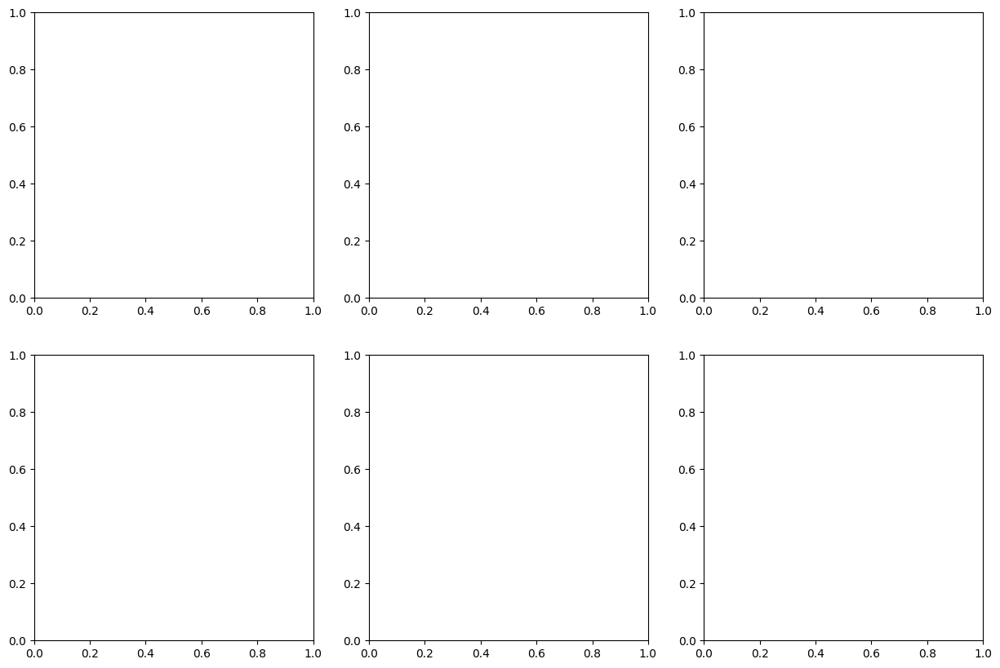

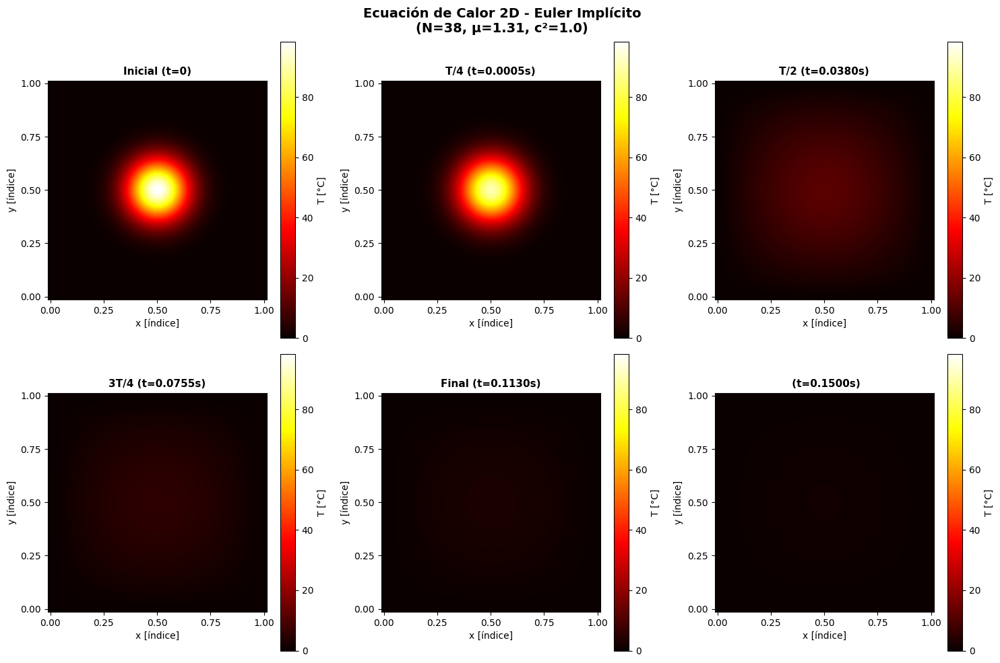

(Gráficos 3D no disponibles)

RESUMEN
T inicial máxima:  98.37°C
T final máxima:    1.20°C
Reducción:         98.8%


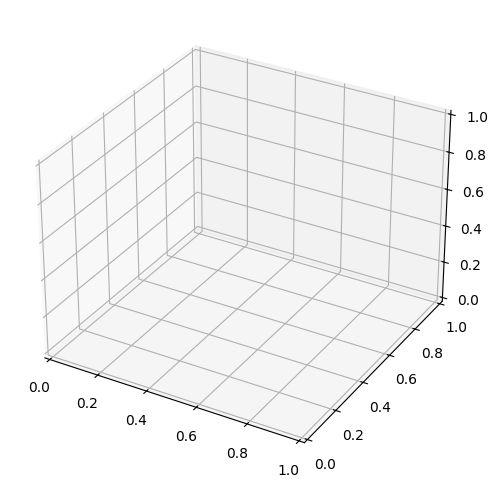

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.sparse import diags, kron, eye, spdiags
from scipy.sparse.linalg import spsolve

print("="*70)
print("ECUACIÓN DE CALOR EN 2D - MÉTODO DE DIFERENCIAS FINITAS")
print("="*70)

# ==============================================================================
# PARÁMETROS FÍSICOS Y NUMÉRICOS
# ==============================================================================
a, b = 1.0, 1.0           # Dominio: [0,a] x [0,b]
N = 38                    # Puntos interiores en cada dirección
h = a / (N + 1)           # Paso espacial
c = 1.0                   # Coeficiente de difusión térmica
T = 0.15                  # Tiempo total
M = 300                   # Número de pasos temporales
k = T / M                 # Paso temporal
mu = (h**2) / (k * c**2)  # Parámetro μ

print(f"\nParámetros:")
print(f"  Dominio: [{0},{a}] x [{0},{b}]")
print(f"  Puntos interiores: {N} x {N}")
print(f"  h = {h:.6f}, k = {k:.6f}, μ = {mu:.6f}")

# ==============================================================================
# CONSTRUCCIÓN DE LA MATRIZ A
# ==============================================================================
def Laplacian2DMatrix(N, mu):
    I = eye(N, format='csr')
    e = np.ones(N)

    # IMPORTANTE: El signo correcto para el sistema implícito
    # (I - dt*c²*Laplacian) u^(n+1) = u^n
    # Donde Laplacian tiene la forma estándar con -2 en diagonal
    T = spdiags([-e, (4 + mu) * e, -e], [-1, 0, 1], N, N, format='csr')
    S = spdiags([-e, -e], [-1, 1], N, N, format='csr')

    A = kron(I, T, format='csr') + kron(S, I, format='csr')
    return A

A = Laplacian2DMatrix(N, mu)
print(f"\nMatriz A: {A.shape[0]} x {A.shape[1]} ({A.nnz} elementos no nulos)")

# ==============================================================================
# CONDICIONES INICIALES Y DE FRONTERA
# ==============================================================================
x = np.linspace(h, a - h, N)
y = np.linspace(h, b - h, N)

def u0(x, y):
    """Condición inicial: pico gaussiano en el centro"""
    x_center, y_center = a/2, b/2
    sigma = 0.1
    return 100.0 * np.exp(-((x - x_center)**2 + (y - y_center)**2) / (2*sigma**2))

def g(t, x, y):
    """Condición de frontera: temperatura 0 en los bordes"""
    return 0.0

def f(t, x, y):
    """Término fuente: sin fuente externa"""
    return 0.0

# ==============================================================================
# CONSTRUCCIÓN DEL VECTOR b^n
# ==============================================================================
def Laplacian2DRhs(N, tn, x, y, h, f, g, mu, u):
    b = np.zeros(N**2)
    k_idx = N**2 - N
    v = y[0]
    w = y[N-1]

    # Bordes inferior y superior
    for i in range(N):
        z = x[i]
        b[i] = h**2 * f(tn, z, v) + g(tn, z, 0)
        b[k_idx + i] = h**2 * f(tn, z, w) + g(tn, z, 1)

    # Esquinas
    b[0] += g(tn, 0, v)
    b[N-1] += g(tn, 1, v)
    b[k_idx] += g(tn, 0, w)
    b[k_idx + N - 1] += g(tn, 1, w)

    # Puntos interiores
    k_idx = N
    for j in range(1, N-1):
        v = y[j]
        for i in range(N):
            b[k_idx + i] = h**2 * f(tn, x[i], v)
        b[k_idx] += g(tn, 0, v)
        k_idx += N
        b[k_idx - 1] += g(tn, 1, v)

    b = b + mu * u
    return b

# ==============================================================================
# INICIALIZACIÓN
# ==============================================================================
u = np.zeros(N**2)
for j in range(N):
    for i in range(N):
        u[j*N + i] = u0(x[i], y[j])

print(f"\nCondición inicial: T_max = {u.max():.2f}°C")

# ==============================================================================
# EVOLUCIÓN TEMPORAL
# ==============================================================================
t = np.linspace(k, T, M)
U_snapshots = []
snapshot_indices = [0, M//4, M//2, 3*M//4, M-1]

# Guardar estado inicial - CONVERTIR A ARRAY NUMPY EXPLÍCITAMENTE
u_initial = np.array(u).reshape(N, N).copy()
U_snapshots.append(u_initial)

print("\nEvolucionando...")
for n in range(M):
    b = Laplacian2DRhs(N, t[n], x, y, h, f, g, mu, u)
    u = spsolve(A, b)

    # Convertir explícitamente a numpy array antes de guardar
    if n in snapshot_indices:
        u_snapshot = np.array(u).reshape(N, N).copy()
        U_snapshots.append(u_snapshot)

    if (n+1) % 100 == 0:
        print(f"  Paso {n+1}/{M}: T_max = {np.max(u):.2f}°C")

print(f"\n✓ Simulación completada!")
print(f"  Snapshots guardados: {len(U_snapshots)}")

# VERIFICACIÓN ADICIONAL
print(f"\nVerificando snapshots:")
for i, snap in enumerate(U_snapshots):
    print(f"  Snapshot {i}: shape = {snap.shape}, type = {type(snap)}")

# ==============================================================================
# VISUALIZACIÓN
# ==============================================================================
def add_boundaries(U_interior):
    """Añade bordes con temperatura 0"""
    # Asegurar que sea numpy array
    U_interior = np.asarray(U_interior)
    N_int = U_interior.shape[0]
    U_full = np.zeros((N_int + 2, N_int + 2))
    U_full[1:-1, 1:-1] = U_interior
    return U_full

# Crear grids completos
x_full = np.linspace(0, a, N + 2)
y_full = np.linspace(0, b, N + 2)

# Preparar datos - VERIFICAR CADA GRID
print("\nPreparando grids para visualización...")
U_grids = []
for i, U in enumerate(U_snapshots):
    U_grid = add_boundaries(U)
    print(f"  Grid {i}: shape = {U_grid.shape}, min = {U_grid.min():.2f}, max = {U_grid.max():.2f}")
    U_grids.append(U_grid)

vmax = U_grids[0].max()
print(f"\nvmax para escala de colores: {vmax:.2f}")

# Gráfico 2D: evolución temporal
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()

titles = ['Inicial (t=0)', 'T/4', 'T/2', '3T/4', 'Final', '']
times = [0] + [t[idx] for idx in snapshot_indices]

# Gráfico 2D: evolución temporal
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()

titles = ['Inicial (t=0)', 'T/4', 'T/2', '3T/4', 'Final', '']
times = [0] + [t[idx] for idx in snapshot_indices]

for idx in range(6):
    ax = axes[idx]
    if idx < len(U_grids):
        print(f"\nGraficando snapshot {idx}...")
        U_plot = np.ascontiguousarray(U_grids[idx].T)
        print(f"  Shape después de transponer: {U_plot.shape}")

        # SIN extent para evitar bug de matplotlib
        im = ax.imshow(U_plot, origin='lower', cmap='hot',
                      vmin=0, vmax=vmax, interpolation='bilinear')

        title = titles[idx]
        if idx > 0:
            title += f' (t={times[idx]:.4f}s)'

        ax.set_title(title, fontsize=11, fontweight='bold')
        ax.set_xlabel('x [índice]')
        ax.set_ylabel('y [índice]')

        # Añadir ticks personalizados para mostrar coordenadas reales
        n_ticks = 5
        tick_positions = np.linspace(0, N+1, n_ticks)
        tick_labels = [f'{x:.2f}' for x in np.linspace(0, a, n_ticks)]
        ax.set_xticks(tick_positions)
        ax.set_xticklabels(tick_labels)
        ax.set_yticks(tick_positions)
        ax.set_yticklabels(tick_labels)

        plt.colorbar(im, ax=ax, label='T [°C]')
    else:
        ax.axis('off')

plt.suptitle(f'Ecuación de Calor 2D - Euler Implícito\n(N={N}, μ={mu:.2f}, c²={c**2})',
             fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

# Gráfico 3D
try:
    from mpl_toolkits.mplot3d import Axes3D

    fig = plt.figure(figsize=(14, 6))
    X, Y = np.meshgrid(x_full, y_full)

    # Inicial
    ax1 = fig.add_subplot(121, projection='3d')
    surf1 = ax1.plot_surface(X, Y, U_grids[0].T, cmap='hot',
                            edgecolor='none', alpha=0.9)
    ax1.set_title('Estado Inicial', fontsize=12, fontweight='bold')
    ax1.set_xlabel('x')
    ax1.set_ylabel('y')
    ax1.set_zlabel('T [°C]')
    ax1.view_init(elev=25, azim=45)
    fig.colorbar(surf1, ax=ax1, shrink=0.5)

    # Final
    ax2 = fig.add_subplot(122, projection='3d')
    surf2 = ax2.plot_surface(X, Y, U_grids[-1].T, cmap='hot',
                            edgecolor='none', alpha=0.9)
    ax2.set_title(f'Estado Final (t={T}s)', fontsize=12, fontweight='bold')
    ax2.set_xlabel('x')
    ax2.set_ylabel('y')
    ax2.set_zlabel('T [°C]')
    ax2.view_init(elev=25, azim=45)
    fig.colorbar(surf2, ax=ax2, shrink=0.5)

    plt.tight_layout()
    plt.show()
except:
    print("(Gráficos 3D no disponibles)")

# Resumen
print("\n" + "="*70)
print("RESUMEN")
print("="*70)
print(f"T inicial máxima:  {U_snapshots[0].max():.2f}°C")
print(f"T final máxima:    {U_snapshots[-1].max():.2f}°C")
print(f"Reducción:         {(1 - U_snapshots[-1].max()/U_snapshots[0].max())*100:.1f}%")
print("="*70)

# **Solución utilizando distintas condiciones iniciales:**

# **Gráfico con mapa de colores:**

NameError: name 'Lx' is not defined

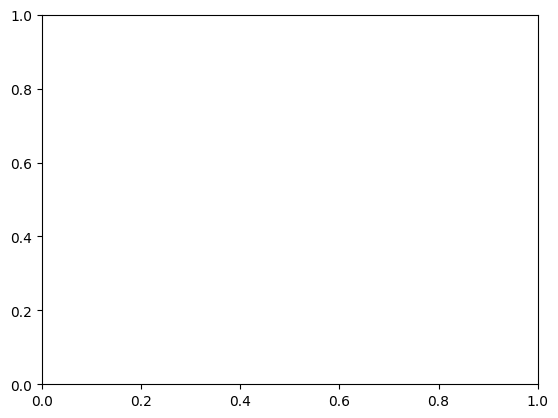

In [ ]:
# Bucle temporal
plt.ion()
fig, ax = plt.subplots()
im = ax.imshow(U, cmap="hot", origin="lower", extent=[0, Lx, 0, Ly])
plt.colorbar(im, ax=ax)
plt.title("Evolución de la temperatura (Euler Implícito)")

for n in range(Nt):
    # Resolver el sistema lineal A * U^{n+1} = U^n
    U_flat = spsolve(A, U_flat)

    # Actualizar visualización cada ciertos pasos
    if n % 10 == 0:
        U = U_flat.reshape(Nx, Ny)
        im.set_data(U)
        plt.pause(0.05)

plt.ioff()
plt.show()

# Resultado final
U_final = U_flat.reshape(Nx, Ny)
plt.figure()
plt.imshow(U_final, cmap="hot", origin="lower", extent=[0, Lx, 0, Ly])
plt.colorbar(label="Temperatura")
plt.title("Distribución final de temperatura (Euler Implícito)")
plt.xlabel("x")
plt.ylabel("y")
plt.show()

# **Aceleración de la aplicación:**

# **Codigo solucion NO GRAFICAS de sofi xd ESCUCHEN EL AUDIO DE WHATSAPP**



In [ ]:
import numpy as np
from scipy.sparse import diags, kron, eye
from scipy.sparse.linalg import spsolve
import time

class HeatEquation2D:

    def __init__(self, N=150, M=200, T=0.5, a=1.0, b=1.0, c=1.0): # constructor de inicializacion
        """
        Parámetros:
        -----------
        N : int
            Número de puntos interiores en cada dirección espacial
        M : int
            Número de pasos de tiempo
        T : float
            Tiempo final de simulación
        a = dimension del dominio en x
        b= dimension del dominio en y
        c= coeficiente de difusion termica
        """
        self.N = N
        self.M = M
        self.T = T
        self.a = a
        self.b = b
        self.c = c #esta parte asigno los parametros a los atributos de la clase

        # Paso espacial y temporal
        self.hx = a / (N + 1) # paso espacial en x
        self.hy = b / (N + 1) # paso esoacial en y
        self.k = T / M # paso temporal

        # parametros de discretizacion
        self.mux = (c**2 * self.k) / self.hx**2 # mu definido en la teoria
        self.muy = (c**2 * self.k) / self.hy**2

        # Malla espacial (solo puntos interiores)
        self.x = np.linspace(self.hx, 1 - self.hx, N) # se define la coordenada x
        self.y = np.linspace(self.hy, 1 - self.hy, N) # se define la coordenada y
        self.X, self.Y = np.meshgrid(self.x, self.y) # se define la malla 2D

        # Construir matriz del sistema
        self.A = self.MatrizLaplaciano() # se construye la matriz del laplaciano

        print(f"Configuración del solver:")
        print(f"  N = {N} (puntos interiores por dimensión)")
        print(f"  M = {M} (pasos de tiempo)")
        # print(f"  h = {self.h:.6f} (paso espacial)") # Undefined attribute, commented out
        print(f"  hx = {self.hx:.6f} (paso espacial en x)")
        print(f"  hy = {self.hy:.6f} (paso espacial en y)")
        print(f"  k = {self.k:.6f} (paso temporal)")
        # print(f"  μ = {self.mu:.6f}") # Undefined attribute, commented out
        print(f"  μx = {self.mux:.6f}")
        print(f"  μy = {self.muy:.6f}")
        print(f"  Tamaño del sistema: {N*N} × {N*N}")

    def MatrizLaplaciano(self):
        """
        Construye la matriz del Laplaciano discreto en 2D.
        Usa productos de Kronecker: A = I ⊗ T + S ⊗ I

        Returns:
        --------
        A : sparse matrix
            Matriz del sistema lineal
        """
        N = self.N

        # Matriz identidad
        I = eye(N, format='csr') # se crea una matriz identidad dispersa de tamaño N

        # Matriz tridiagonal T (diagonal principal y sub/superdiagonales)
        # For an N x N matrix, the main diagonal has N elements, off-diagonals have N-1 elements.
        e_main = np.ones(N)
        e_off = np.ones(N - 1)
        coef_diagonal = 1 + 2 * (self.mux + self.muy)
        # Corrected typo: self_mux -> self.mux
        T = diags([-self.mux * e_off, coef_diagonal * e_main, -self.mux * e_off], [-1, 0, 1], format='csr')

        # Matriz S (sub/superdiagonales solamente)
        # For an N x N matrix, off-diagonals have N-1 elements.
        # Corrected typo: self_muy -> self.muy
        S = diags([-self.muy * e_off, -self.muy * e_off], [-1, 1], format='csr')

        # Producto de Kronecker
        A = kron(I, T, format='csr') + kron(S, I, format='csr')

        return A

    def VectorRHS(self, tn, u_prev):
        """
        Construye el vector del lado derecho (RHS) del sistema lineal,
        asumiendo que f_func y g_func son siempre cero.

        Parámetros:
        -----------
        tn : float
            Tiempo actual (no usado si f_func y g_func son cero)
        u_prev : ndarray
            Solución del paso de tiempo anterior

        Returns:
        --------
        b : ndarray
            Vector del lado derecho
        """
        N = self.N

        b = np.zeros(N * N)

        # Los términos de los bordes ya se manejan con 0 implícitamente aquí.

        # Agregar contribución del paso temporal anterior
        b = u_prev.copy()

        return b

    def solve(self, u0_func, save_every=1):
        """
        Resuelve la ecuación de calor.

        Parámetros:
        -----------
        u0_func : callable
            Condición inicial u0(x, y)
        f_func : callable, opcional
            Función fuente f(t, x, y). Default: 0 (Ahora no se usa en _build_rhs)
        g_func : callable, opcional
            Condición de frontera g(t, x, y). Default: 0 (Ahora no se usa en _build_rhs)
        save_every : int
            Guardar la solución cada 'save_every' pasos

        Returns:
        --------
        solutions : list of ndarray
            Soluciones guardadas en cada paso
        times : list of float
            Tiempos correspondientes
        """
        # f_func y g_func ya no son usados por _build_rhs simplificado
        # if f_func is None:
        #     f_func = lambda t, x, y: 0.0
        # if g_func is None:
        #     g_func = lambda t, x, y: 0.0

        N = self.N

        # Condición inicial
        u0 = np.zeros(N * N)
        for j in range(N):
            for i in range(N):
                u0[j*N + i] = u0_func(self.x[i], self.y[j])

        soluciones = [u0.reshape(N, N).copy()]
        tiempos = [0.0]

        u_prev = u0

        print(f"\nResolviendo ecuación de calor...")
        start_time = time.time()

        # Evolución temporal
        for n in range(1, self.M + 1):
            tn = n * self.k

            # Construir lado derecho
            # Corrected VectorRHS call: now `tn` is in the signature
            b = self.VectorRHS(tn, u_prev)

            # Resolver sistema lineal Au = b
            u_actual = spsolve(self.A, b)

            # Guardar solución
            if n % save_every == 0 or n == self.M:
                soluciones.append(u_actual.reshape(N, N).copy())
                tiempos.append(tn)

            u_prev = u_actual


        lapso = time.time() - start_time
        print(f"Completado en {lapso:.2f} segundos")

        return soluciones, tiempos


# ============================================================================
# CONDICIONES INICIALES PREDEFINIDAS
# ============================================================================

def DistribucionGaussiana(x, y):
    """Gaussiana centrada en (0.5, 0.5)"""
    return 100 * np.exp(-50 * ((x - 0.5)**2 + (y - 0.5)**2))

def Anillo(x, y):
    """Forma de anillo"""
    r = np.sqrt((x - 0.5)**2 + (y - 0.5)**2)
    return 100 * np.exp(-200 * (r - 0.3)**2)

def Diagonal(x, y):
    """Diagonal"""
    return 100 * np.exp(-100 * (x - y)**2)

def FormaU(x, y):
    """Forma de letra U"""
    left = np.exp(-200 * ((x - 0.25)**2 + (y - 0.5)**2))
    right = np.exp(-200 * ((x - 0.75)**2 + (y - 0.5)**2))
    bottom = np.exp(-200 * ((x - 0.5)**2 + (y - 0.25)**2))
    return 100 * (left + right + bottom)

def analyze_min_max(soluciones, tiempos):
    for i, (sol, t) in enumerate(zip(soluciones, tiempos)):
        u_max = sol.max()
        u_min = sol.min()
        print(f"  Tiempo: {t:.4f} | Temp. máxima: {u_max:.4f} | Temp. mínima: {u_min:.4f}")


# ============================================================================
# EJEMPLOS DE USO
# ============================================================================

if __name__ == "__main__":
    print("=" * 70)
    print("ECUACIÓN DE CALOR EN 2D - MÉTODO DE DIFERENCIAS FINITAS")
    print("=" * 70)

    # parametros explicitos
    a = 1.0
    b = 1.0
    c = 1.0

    # Ejemplo 1: Gaussiana central
    print("\nPrimera configuración: Distribución Gaussiana en el centro")
    print("-" * 70)
    solver1 = HeatEquation2D(N=100, M=200, T=0.65, a=a, b=b, c=c)
    soluciones1, tiempos1 = solver1.solve(DistribucionGaussiana, save_every=2)
    analyze_min_max(soluciones1, tiempos1)

    # Ejemplo 2: Anillo
    print("\nTercera configuración: Anillo")
    print("-" * 70)
    solver2 = HeatEquation2D(N=100, M=200, T=0.65, a=a, b=b, c=c)
    soluciones2, tiempos2 = solver2.solve(Anillo, save_every=2)
    analyze_min_max(soluciones2, tiempos2)

    # Ejemplo 3: Diagonal caliente
    print("\nCuarta configuración: Diagonal")
    print("-" * 70)
    solver3 = HeatEquation2D(N=100, M=200, T=0.65, a=a, b=b, c=c)
    soluciones3, tiempos3 = solver3.solve(Diagonal, save_every=2)
    analyze_min_max(soluciones3, tiempos3)

    # Ejemplo 4: Forma de U
    print("\nQuinta configuración: Forma de U")
    print("-" * 70)
    solver4 = HeatEquation2D(N=100, M=200, T=0.65, a=a, b=b, c=c)
    soluciones4, tiempos4 = solver4.solve(FormaU, save_every=2)
    analyze_min_max(soluciones4, tiempos4)


ECUACIÓN DE CALOR EN 2D - MÉTODO DE DIFERENCIAS FINITAS

Primera configuración: Distribución Gaussiana en el centro
----------------------------------------------------------------------
Configuración del solver:
  N = 100 (puntos interiores por dimensión)
  M = 200 (pasos de tiempo)
  hx = 0.009901 (paso espacial en x)
  hy = 0.009901 (paso espacial en y)
  k = 0.003250 (paso temporal)
  μx = 33.153250
  μy = 33.153250
  Tamaño del sistema: 10000 × 10000

Resolviendo ecuación de calor...
Completado en 9.84 segundos
  Tiempo: 0.0000 | Temp. máxima: 99.7552 | Temp. mínima: 0.0000
  Tiempo: 0.0065 | Temp. máxima: 49.6576 | Temp. mínima: 0.0006
  Tiempo: 0.0130 | Temp. máxima: 31.4250 | Temp. mínima: 0.0023
  Tiempo: 0.0195 | Temp. máxima: 22.6344 | Temp. mínima: 0.0045
  Tiempo: 0.0260 | Temp. máxima: 17.5668 | Temp. mínima: 0.0063
  Tiempo: 0.0325 | Temp. máxima: 14.2732 | Temp. mínima: 0.0073
  Tiempo: 0.0390 | Temp. máxima: 11.9403 | Temp. mínima: 0.0077
  Tiempo: 0.0455 | Temp. máxim

# Graficas

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display
def crear_animacion(soluciones, tiempos, titulo, intervalo=500):

    fig, ax = plt.subplots(figsize=(8, 7))
    plt.close()

    vmin = min(sol.min() for sol in soluciones)
    vmax = max(sol.max() for sol in soluciones)

    im = ax.imshow(soluciones[0], cmap='hot', interpolation='bilinear',
                   origin='lower', vmin=vmin, vmax=vmax, extent=[0, 1, 0, 1])

    cbar = plt.colorbar(im, ax=ax, label='Temperatura')
    texto_info = ax.text(0.02, 0.98, '', transform=ax.transAxes,
                        verticalalignment='top', bbox=dict(boxstyle='round',
                        facecolor='white', alpha=0.8), fontsize=10)

    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_title(titulo, fontsize=14, fontweight='bold', pad=20)

    def actualizar(frame):
        im.set_array(soluciones[frame])

        t = tiempos[frame]
        temp_max = soluciones[frame].max()
        temp_min = soluciones[frame].min()

        info = f't = {t:.4f}\nMax = {temp_max:.2f}\nMin = {temp_min:.2f}'
        texto_info.set_text(info)

        return [im, texto_info]

    anim = FuncAnimation(fig, actualizar, frames=len(soluciones),
                        interval=intervalo, blit=True, repeat=True)

    plt.tight_layout()
    return anim


def generar_animaciones():
    N = 100
    M = 200
    T = 0.4

    condiciones = [
        (DistribucionGaussiana, "Distribución Gaussiana"),
        (Anillo, "Anillo"),
        (Diagonal, "Diagonal"),
        (FormaU, "Forma de U")
    ]

    animaciones_html = []

    for i, (condicion, nombre) in enumerate(condiciones, 1):
        print(f"\n{'='*70}")
        print(f"Generando animación {i}/4: {nombre}")
        print(f"{'='*70}")

        solver = HeatEquation2D(N=N, M=M, T=T)
        soluciones, tiempos = solver.solve(condicion, save_every=2)

        anim = crear_animacion(soluciones, tiempos, nombre, intervalo=500)

        html_anim = HTML(anim.to_jshtml())
        animaciones_html.append(html_anim)

    return animaciones_html


if __name__ == "__main__":

    animaciones = generar_animaciones()

    for i, anim in enumerate(animaciones, 1):
        print(f"Animación {i}/4")
        display(anim)
        print()


Generando animación 1/4: Distribución Gaussiana
Configuración del solver:
  N = 100 (puntos interiores por dimensión)
  M = 200 (pasos de tiempo)
  hx = 0.009901 (paso espacial en x)
  hy = 0.009901 (paso espacial en y)
  k = 0.002000 (paso temporal)
  μx = 20.402000
  μy = 20.402000
  Tamaño del sistema: 10000 × 10000

Resolviendo ecuación de calor...
Completado en 11.21 segundos


/tmp/ipython-input-2449671950.py:15: UserWarning: Adding colorbar to a different Figure <Figure size 800x700 with 2 Axes> than <Figure size 640x480 with 0 Axes> which fig.colorbar is called on.
  cbar = plt.colorbar(im, ax=ax, label='Temperatura')



Generando animación 2/4: Anillo
Configuración del solver:
  N = 100 (puntos interiores por dimensión)
  M = 200 (pasos de tiempo)
  hx = 0.009901 (paso espacial en x)
  hy = 0.009901 (paso espacial en y)
  k = 0.002000 (paso temporal)
  μx = 20.402000
  μy = 20.402000
  Tamaño del sistema: 10000 × 10000

Resolviendo ecuación de calor...
Completado en 9.98 segundos


/tmp/ipython-input-2449671950.py:15: UserWarning: Adding colorbar to a different Figure <Figure size 800x700 with 2 Axes> than <Figure size 640x480 with 0 Axes> which fig.colorbar is called on.
  cbar = plt.colorbar(im, ax=ax, label='Temperatura')



Generando animación 3/4: Diagonal
Configuración del solver:
  N = 100 (puntos interiores por dimensión)
  M = 200 (pasos de tiempo)
  hx = 0.009901 (paso espacial en x)
  hy = 0.009901 (paso espacial en y)
  k = 0.002000 (paso temporal)
  μx = 20.402000
  μy = 20.402000
  Tamaño del sistema: 10000 × 10000

Resolviendo ecuación de calor...
Completado en 9.16 segundos


/tmp/ipython-input-2449671950.py:15: UserWarning: Adding colorbar to a different Figure <Figure size 800x700 with 2 Axes> than <Figure size 640x480 with 0 Axes> which fig.colorbar is called on.
  cbar = plt.colorbar(im, ax=ax, label='Temperatura')



Generando animación 4/4: Forma de U
Configuración del solver:
  N = 100 (puntos interiores por dimensión)
  M = 200 (pasos de tiempo)
  hx = 0.009901 (paso espacial en x)
  hy = 0.009901 (paso espacial en y)
  k = 0.002000 (paso temporal)
  μx = 20.402000
  μy = 20.402000
  Tamaño del sistema: 10000 × 10000

Resolviendo ecuación de calor...
Completado en 9.55 segundos


/tmp/ipython-input-2449671950.py:15: UserWarning: Adding colorbar to a different Figure <Figure size 800x700 with 2 Axes> than <Figure size 640x480 with 0 Axes> which fig.colorbar is called on.
  cbar = plt.colorbar(im, ax=ax, label='Temperatura')


Animación 1/4



Animación 2/4



Animación 3/4



Animación 4/4


<Figure size 640x480 with 0 Axes>

# solucion otra vez xd esto tiene solucion y grafico y es con menu

In [5]:
import numpy as np
from scipy.sparse import diags, kron, eye, lil_matrix
from scipy.sparse.linalg import spsolve
import time
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

class HeatEquation2D:

    def __init__(self, N=150, M=200, T=0.5, a=1.0, b=1.0, c=1.0,
                 condiciones_frontera=None):
        self.N = N # numero de puntos interiores en x y y
        self.M = M # numero de pasos temporales
        self.T = T # tiempo final de simulacion
        self.a = a # longitud del dominio en x
        self.b = b # longitud del dominio en y
        self.c = c # coeficiente de difusion termica

        # Paso espacial y temporal, todo esto esta definido en la teoria
        self.hx = a / (N + 1) # N + 1 pq si se tienen N puntos interiores, hay que dividir el dominio en N+1 segmentos
        self.hy = b / (N + 1)
        self.k = T / M

        # Parámetros de discretización, esto se deriva en la teoria, por la estabilidad del metodo, no tiene que ser algun valor especifico
        self.mux = (c**2 * self.k) / self.hx**2
        self.muy = (c**2 * self.k) / self.hy**2

        # Malla espacial sin incluir las fronteras
        self.x = np.linspace(self.hx, a - self.hx, N)
        self.y = np.linspace(self.hy, b - self.hy, N)
        self.X, self.Y = np.meshgrid(self.x, self.y)

        # Condiciones de frontera de dirichlet homogeneas, o sea, temperatura 0 en todas las fronteras
        if condiciones_frontera is None:
            self.condiciones_frontera = {
                'left': {'type': 'dirichlet', 'value': 0.0},
                'right': {'type': 'dirichlet', 'value': 0.0},
                'bottom': {'type': 'dirichlet', 'value': 0.0},
                'top': {'type': 'dirichlet', 'value': 0.0}
            }
        else:
            self.condiciones_frontera = condiciones_frontera

        # Construir matriz del sistema
        self.A = self.MatrizLaplaciano()

        print(f"Configuración del solver:")
        print(f"  N = {N} (puntos interiores por dimensión)")
        print(f"  M = {M} (pasos de tiempo)")
        print(f"  hx = {self.hx:.6f} (paso espacial en x)")
        print(f"  hy = {self.hy:.6f} (paso espacial en y)")
        print(f"  k = {self.k:.6f} (paso temporal)")
        print(f"  μx = {self.mux:.6f}")
        print(f"  μy = {self.muy:.6f}")
        print(f"  Tamaño del sistema: {N*N} × {N*N}")
        print(f"\nCondiciones de frontera:")
        for lado, cond in self.condiciones_frontera.items():
            print(f"  {lado}: {cond['type']} = {cond['value']}")

    def MatrizLaplaciano(self):
        """
        Versión más robusta que maneja explícitamente todos los casos,
        incluyendo esquinas con condiciones mixtas.
        """
        N = self.N
        A = lil_matrix((N * N, N * N))

        # Pre-calcular tipos de condiciones para cada borde
        left_type = self.condiciones_frontera['left']['type']
        right_type = self.condiciones_frontera['right']['type']
        bottom_type = self.condiciones_frontera['bottom']['type']
        top_type = self.condiciones_frontera['top']['type']

        for j in range(N):
            for i in range(N):
                idx = j * N + i

                # -------------------------------------------------
                # DIAGONAL: SIEMPRE 1 + 2μx + 2μy
                # -------------------------------------------------
                A[idx, idx] = 1.0 + 2.0 * self.mux + 2.0 * self.muy

                # -------------------------------------------------
                # VECINOS EN X
                # -------------------------------------------------

                # ¿Está en borde izquierdo?
                if i == 0:
                    if left_type == 'neumann':
                        # En borde izquierdo con Neumann
                        # No hay coeficiente para vecino izquierdo (fantasma)
                        # Pero el vecino derecho (si existe) tiene -2μx
                        if i < N - 1:  # Existe vecino derecho
                            A[idx, idx + 1] = -2.0 * self.mux
                    else:
                        # Dirichlet en borde izquierdo
                        # Coeficiente normal para vecino derecho
                        if i < N - 1:
                            A[idx, idx + 1] = -self.mux
                # ¿Está en borde derecho?
                elif i == N - 1:
                    if right_type == 'neumann':
                        # En borde derecho con Neumann
                        # Vecino izquierdo tiene -2μx
                        A[idx, idx - 1] = -2.0 * self.mux
                    else:
                        # Dirichlet en borde derecho
                        # Coeficiente normal para vecino izquierdo
                        A[idx, idx - 1] = -self.mux
                else:
                    # Punto interior en x
                    A[idx, idx - 1] = -self.mux  # Vecino izquierdo
                    A[idx, idx + 1] = -self.mux  # Vecino derecho

                # -------------------------------------------------
                # VECINOS EN Y
                # -------------------------------------------------

                # ¿Está en borde inferior?
                if j == 0:
                    if bottom_type == 'neumann':
                        # En borde inferior con Neumann
                        # Vecino superior (si existe) tiene -2μy
                        if j < N - 1:
                            A[idx, idx + N] = -2.0 * self.muy
                    else:
                        # Dirichlet en borde inferior
                        if j < N - 1:
                            A[idx, idx + N] = -self.muy
                # ¿Está en borde superior?
                elif j == N - 1:
                    if top_type == 'neumann':
                        # En borde superior con Neumann
                        # Vecino inferior tiene -2μy
                        A[idx, idx - N] = -2.0 * self.muy
                    else:
                        # Dirichlet en borde superior
                        A[idx, idx - N] = -self.muy
                else:
                    # Punto interior en y
                    A[idx, idx - N] = -self.muy  # Vecino inferior
                    A[idx, idx + N] = -self.muy  # Vecino superior

        return A.tocsr()

    def obtener_valor_frontera(self, lado, t, pos):
        """
        Obtiene el valor de la condición de frontera en un tiempo y posición dados.
        """
        value = self.condiciones_frontera[lado]['value']
        if callable(value):
            return value(t, pos)
        else:
            return value

    def VectorRHS(self, tn, u_prev):
        """
        Construye el vector RHS con la corrección matemáticamente correcta.

        Fórmulas según deducción:
        - Borde izquierdo Neumann:  b = uⁿ - 2μx·hx·g
        - Borde derecho Neumann:    b = uⁿ + 2μx·hx·g
        - Borde inferior Neumann:   b = uⁿ - 2μy·hy·g
        - Borde superior Neumann:   b = uⁿ + 2μy·hy·g
        - Dirichlet:                b = uⁿ + μ·g (como antes)
        """
        N = self.N
        b = u_prev.copy()  # Empezamos con la solución del paso anterior

        # ---------------------------------------------------------
        # 1. BORDES VERTICALES (izquierdo y derecho)
        # ---------------------------------------------------------
        for j in range(N):
            y_pos = self.y[j]  # Posición en y para evaluar condiciones

            # ----- BORDE IZQUIERDO (i=0) -----
            idx_left = j * N  # j*N + 0
            if self.condiciones_frontera['left']['type'] == 'dirichlet':
                # Dirichlet: u = g en el borde
                g_left = self.obtener_valor_frontera('left', tn, y_pos)
                # El término -μx·u(-1) se mueve al RHS como +μx·g
                b[idx_left] += self.mux * g_left

            elif self.condiciones_frontera['left']['type'] == 'neumann':
                # Neumann: ∂u/∂x = g en el borde
                g_left = self.obtener_valor_frontera('left', tn, y_pos)
                # Según deducción: b = uⁿ - 2μx·hx·g
                b[idx_left] -= 2.0 * self.mux * self.hx * g_left

            # ----- BORDE DERECHO (i=N-1) -----
            idx_right = j * N + (N - 1)
            if self.condiciones_frontera['right']['type'] == 'dirichlet':
                g_right = self.obtener_valor_frontera('right', tn, y_pos)
                b[idx_right] += self.mux * g_right

            elif self.condiciones_frontera['right']['type'] == 'neumann':
                g_right = self.obtener_valor_frontera('right', tn, y_pos)
                # Según deducción: b = uⁿ + 2μx·hx·g
                b[idx_right] += 2.0 * self.mux * self.hx * g_right

        # ---------------------------------------------------------
        # 2. BORDES HORIZONTALES (inferior y superior)
        # ---------------------------------------------------------
        for i in range(N):
            x_pos = self.x[i]  # Posición en x para evaluar condiciones

            # ----- BORDE INFERIOR (j=0) -----
            idx_bottom = i  # 0*N + i = i
            if self.condiciones_frontera['bottom']['type'] == 'dirichlet':
                g_bottom = self.obtener_valor_frontera('bottom', tn, x_pos)
                b[idx_bottom] += self.muy * g_bottom

            elif self.condiciones_frontera['bottom']['type'] == 'neumann':
                g_bottom = self.obtener_valor_frontera('bottom', tn, x_pos)
                # Según deducción: b = uⁿ - 2μy·hy·g
                b[idx_bottom] -= 2.0 * self.muy * self.hy * g_bottom

            # ----- BORDE SUPERIOR (j=N-1) -----
            idx_top = (N - 1) * N + i
            if self.condiciones_frontera['top']['type'] == 'dirichlet':
                g_top = self.obtener_valor_frontera('top', tn, x_pos)
                b[idx_top] += self.muy * g_top

            elif self.condiciones_frontera['top']['type'] == 'neumann':
                g_top = self.obtener_valor_frontera('top', tn, x_pos)
                # Según deducción: b = uⁿ + 2μy·hy·g
                b[idx_top] += 2.0 * self.muy * self.hy * g_top

        return b

    def obtener_valor_frontera(self, lado, t, pos):
        """
        Obtiene el valor de la condición de frontera.
        Si es una función, la evalúa; si es un número, lo devuelve.
        """
        value = self.condiciones_frontera[lado]['value']
        if callable(value):
            return value(t, pos)
        return value

    def solve(self, u0_func, save_every=1):
        """
        Resuelve la ecuación de calor usando la aproximación corregida.
        """
        N = self.N

        # -------------------------------------------------
        # 1. Condición inicial
        # -------------------------------------------------
        u0 = np.zeros(N * N)
        for j in range(N):
            for i in range(N):
                idx = j * N + i
                u0[idx] = u0_func(self.x[i], self.y[j])

        soluciones = [u0.reshape(N, N).copy()]
        tiempos = [0.0]
        u_prev = u0

        print(f"Resolviendo...")

        # -------------------------------------------------
        # 2. Evolución temporal
        # -------------------------------------------------
        for n in range(1, self.M + 1):
            tn = n * self.k  # Tiempo actual

            # Construir RHS corregido
            b = self.VectorRHS(tn, u_prev)

            # Resolver sistema lineal A·u^{n+1} = b
            u_actual = spsolve(self.A, b)

            # Guardar si corresponde
            if n % save_every == 0 or n == self.M:
                soluciones.append(u_actual.reshape(N, N).copy())
                tiempos.append(tn)

            u_prev = u_actual

        return soluciones, tiempos

# Condiciones Iniciales con T de 100 grados celsius

def DistribucionGaussiana(x, y):
    """Gaussiana centrada en (0.5, 0.5)"""
    return 100 * np.exp(-50 * ((x - 0.5)**2 + (y - 0.5)**2))

def Anillo(x, y):
    """Forma de anillo"""
    r = np.sqrt((x - 0.5)**2 + (y - 0.5)**2)
    return 100 * np.exp(-200 * (r - 0.3)**2)

def Diagonal(x, y):
    """Diagonal"""
    return 100 * np.exp(-100 * (x - y)**2)

def FormaU(x, y):
    """Forma de letra U"""
    left = np.exp(-200 * ((x - 0.25)**2 + (y - 0.5)**2))
    right = np.exp(-200 * ((x - 0.75)**2 + (y - 0.5)**2))
    bottom = np.exp(-200 * ((x - 0.5)**2 + (y - 0.25)**2))
    return 100 * (left + right + bottom)

def analyze_min_max(soluciones, tiempos):
    print("\nAnálisis de temperatura:")
    for i, (sol, t) in enumerate(zip(soluciones, tiempos)):
        u_max = sol.max()
        u_min = sol.min()
        print(f"  t={t:.4f} | Temp. máx: {u_max:.4f} | Temp. mín: {u_min:.4f}")


def seleccionar_condicion_inicial():
    """
    Permite al usuario seleccionar una condición inicial.
    """
    print("Selección de condición inicial")
    print("  1. Distribución Gaussiana")
    print("  2. Anillo")
    print("  3. Diagonal")
    print("  4. Forma de U")

    condiciones = {
        1: ("Distribución Gaussiana", DistribucionGaussiana),
        2: ("Anillo", Anillo),
        3: ("Diagonal", Diagonal),
        4: ("Forma de U", FormaU)
    }

    while True:
        try:
            opcion = int(input("\nSeleccione una opción (1-4): ").strip())
            if opcion in condiciones:
                nombre, funcion = condiciones[opcion]
                print(f"\nSeleccionado: {nombre}")
                return funcion
            else:
                print("Error: Ingrese un número entre 1 y 4")
        except ValueError:
            print("Error: Ingrese un número válido")


def solicitar_condiciones_frontera():
    """
    Solicita al usuario las condiciones de frontera para cada lado del dominio.
    """
    print("Configuración de condiciones de frontera")
    print("\nTipos de condición:")
    print("  Dirichlet: temperatura fija en la frontera")
    print("  Neumann: flujo de calor en la frontera (0 = aislado)")

    condiciones_frontera = {}
    lados = ['left', 'right', 'bottom', 'top']
    lado_nombres = {
        'left': 'Izquierdo',
        'right': 'Derecho',
        'bottom': 'Inferior',
        'top': 'Superior'
    }

    for lado in lados:
        print(f"\n--- Borde {lado_nombres[lado]} ---")

        while True:
            tipo = input(f"Tipo de condición (dirichlet/neumann): ").strip().lower()
            if tipo in ['dirichlet', 'neumann', 'd', 'n']:
                if tipo == 'd':
                    tipo = 'dirichlet'
                elif tipo == 'n':
                    tipo = 'neumann'
                break
            print("Error: Ingrese 'dirichlet' (o 'd') o 'neumann' (o 'n')")

        while True:
            try:
                valor_str = input(f"Valor: ").strip()
                valor = float(valor_str)
                break
            except ValueError:
                print("Error: Ingrese un número válido")

        condiciones_frontera[lado] = {'type': tipo, 'value': valor}

    return condiciones_frontera


def crear_animacion(soluciones, tiempos, titulo, condiciones_frontera, intervalo=500):
    """
    Crea una animación de la evolución de la ecuación de calor.

    Parámetros:
    -----------
    soluciones : list of ndarray
        Lista con las soluciones en cada tiempo guardado
    tiempos : list of float
        Lista con los tiempos correspondientes
    titulo : str
        Título de la animación
    boundary_conditions : dict
        Condiciones de frontera usadas
    intervalo : int
        Milisegundos entre frames (más alto = más lento)
    """
    fig, ax = plt.subplots(figsize=(10, 8))

    vmin = min(sol.min() for sol in soluciones)
    vmax = max(sol.max() for sol in soluciones)

    im = ax.imshow(soluciones[0], cmap='hot', interpolation='bilinear',
                   origin='lower', vmin=vmin, vmax=vmax, extent=[0, 1, 0, 1])

    cbar = plt.colorbar(im, ax=ax, label='Temperatura')

    # Texto con información dinámica
    texto_info = ax.text(0.02, 0.98, '', transform=ax.transAxes,
                        verticalalignment='top', bbox=dict(boxstyle='round',
                        facecolor='white', alpha=0.8), fontsize=10)

    # Información de condiciones de frontera (estática)
    bc_text = "Condiciones de frontera:\n"
    for lado, cond in condiciones_frontera.items():
        bc_text += f"{lado}: {cond['type']} = {cond['value']}\n"

    texto_bc = ax.text(0.98, 0.98, bc_text, transform=ax.transAxes,
                      verticalalignment='top', horizontalalignment='right',
                      bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.7),
                      fontsize=8)

    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_title(titulo, fontsize=14, fontweight='bold', pad=20)

    def actualizar(frame):
        im.set_array(soluciones[frame])

        t = tiempos[frame]
        temp_max = soluciones[frame].max()
        temp_min = soluciones[frame].min()

        info = f't = {t:.4f}\nMax = {temp_max:.2f}\nMin = {temp_min:.2f}'
        texto_info.set_text(info)

        return [im, texto_info]

    anim = FuncAnimation(fig, actualizar, frames=len(soluciones),
                        interval=intervalo, blit=True, repeat=True)

    plt.tight_layout()
    plt.close()  # Cerrar para evitar mostrar frame estático
    return anim


#=

if __name__ == "__main__":
    print("=" * 70)
    print("ECUACIÓN DE CALOR EN 2D")
    print("=" * 70)

    # Parámetros del dominio
    a = 1.0
    b = 1.0
    c = 1.0

    # Seleccionar condición inicial
    condicion_inicial = seleccionar_condicion_inicial()

    # Solicitar condiciones de frontera al usuario
    condicion_frontera = solicitar_condiciones_frontera()

    # Resolver con las condiciones especificadas
    print("Iniciando simulación...")

    solver = HeatEquation2D(N=250, M=500, T=0.65, a=a, b=b, c=c,
                            condiciones_frontera=condicion_frontera)

    soluciones, tiempos = solver.solve(condicion_inicial, save_every=5)

    analyze_min_max(soluciones, tiempos)

    print("Generando animación...")

    # crear animación
    nombre_condicion = {
        DistribucionGaussiana: "Distribución Gaussiana",
        Anillo: "Anillo",
        Diagonal: "Diagonal",
        FormaU: "Forma de U"
    }.get(condicion_inicial, "Condición inicial personalizada")

    anim = crear_animacion(soluciones, tiempos,
                          f"Ecuación de Calor 2D - {nombre_condicion}",
                          condicion_frontera, intervalo=500)

    print("\nAnimación generada. Mostrando...")

    # esto es para mostrar como animacion dentro de colab
    display(HTML(anim.to_jshtml()))

    print("Simulación completada.")

ECUACIÓN DE CALOR EN 2D
Selección de condición inicial
  1. Distribución Gaussiana
  2. Anillo
  3. Diagonal
  4. Forma de U

Seleccione una opción (1-4): 2

Seleccionado: Anillo
Configuración de condiciones de frontera

Tipos de condición:
  Dirichlet: temperatura fija en la frontera
  Neumann: flujo de calor en la frontera (0 = aislado)

--- Borde Izquierdo ---
Tipo de condición (dirichlet/neumann): d
Valor: 30

--- Borde Derecho ---
Tipo de condición (dirichlet/neumann): n
Valor: -10

--- Borde Inferior ---
Tipo de condición (dirichlet/neumann): d
Valor: 30

--- Borde Superior ---
Tipo de condición (dirichlet/neumann): n
Valor: -20
Iniciando simulación...
Configuración del solver:
  N = 250 (puntos interiores por dimensión)
  M = 500 (pasos de tiempo)
  hx = 0.003984 (paso espacial en x)
  hy = 0.003984 (paso espacial en y)
  k = 0.001300 (paso temporal)
  μx = 81.901300
  μy = 81.901300
  Tamaño del sistema: 62500 × 62500

Condiciones de frontera:
  left: dirichlet = 30.0
  right: 

Simulación completada.


**Solucion en C++**